#### Computing du score 1 à partir du TMJA national

##### PARTIE 2 : CALCUL DE LA ROUTE LA PLUS PROCHE DU RESAU NATIONAL POUR CHAQUE COMMUNE

Notebook amorcé par : Jesshuan

Objectifs :

- Récupération du fichier tmja avec le betweeness intégré

- association, pour chaque point commune, de sa route la plus proche , sa distance à la route, le betweeness de la route

- composition du score 1 pour chaque commune

Imports :

In [1]:
import geopandas as gpd
import pandas as pd
import geopy.distance
import os
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import copy
import requests
import zipfile
import io
import shutil

from neo4j import GraphDatabase, basic_auth

In [2]:
# data_path = 'C:/Users/demo/Desktop/Lattitude/datas/'
data_path = 'datas'
os.makedirs(data_path, exist_ok=True)

In [3]:
file_name = 'TMJA2018_enriched_and_betweeness'

tmja_enriched = gpd.read_feather(os.path.join(data_path,file_name + '.feather'))

In [ ]:
# Mika a récupéré les geojson des communes dans car_vizs et get-geo-data. Apparemment c'est lourd.

data_path = 'datas'
file_name2 = 'communes-20220101'
ext2 = '.shp'
url ='https://www.data.gouv.fr/fr/datasets/r/0e117c06-248f-45e5-8945-0e79d9136165'
temp_path = 'temp_unzip'


try: 
    communes = gpd.read_feather(os.path.join(data_path,file_name2 + '.feather'))
except:
    # Zip file from url  
    zip_file = requests.get(url).content
    os.makedirs(temp_path, exist_ok=True)
    with zipfile.ZipFile(io.BytesIO(zip_file)) as archive:
        archive.extractall(temp_path)
    communes = gpd.read_file(os.path.join(temp_path,file_name2 + ext2))   
    shutil.rmtree(temp_path) 
    
    

In [17]:
communes

,insee,nom,wikipedia,surf_ha,geometry
0,2B222,Pie-d'Orezza,fr:Pie-d'Orezza,573.0,"POLYGON ((9.32017 42.38507, 9.32028 42.38510, ..."
1,2B137,Lano,fr:Lano,824.0,"POLYGON ((9.20010 42.39013, 9.20014 42.39014, ..."
2,2B051,Cambia,fr:Cambia,833.0,"POLYGON ((9.27757 42.37509, 9.27758 42.37512, ..."
3,2B106,Érone,fr:Érone,393.0,"POLYGON ((9.25119 42.37605, 9.25132 42.37603, ..."
4,2B185,Oletta,fr:Oletta,2674.0,"POLYGON ((9.28340 42.66273, 9.28345 42.66273, ..."
...,...,...,...,...,...
34950,80122,Bouquemaison,fr:Bouquemaison,724.0,"POLYGON ((2.31459 50.23489, 2.31746 50.23535, ..."
34951,62795,Sibiville,fr:Sibiville,738.0,"POLYGON ((2.30945 50.31902, 2.30969 50.31913, ..."
34952,62694,Rebreuve-sur-Canche,fr:Rebreuve-sur-Canche,842.0,"POLYGON ((2.32074 50.24767, 2.32077 50.24771, ..."
34953,62831,Troisvaux,fr:Troisvaux,620.0,"POLYGON ((2.32046 50.40520, 2.32137 50.40571, ..."


In [14]:
communes.to_feather(os.path.join(data_path,file_name2 + '.feather'))

--------------

On ne garde que les communes en métropole (association avec le fichier de TMJA qui n'est que métropolitain):

In [21]:
extra_metropole = [code_insee for code_insee in communes['insee'].to_list() if code_insee[0:2]=='2A' or code_insee[0:2]=='2B' or code_insee[0:2]=='97' or code_insee[0:2]=='98']

In [22]:
communes_metropole = communes.loc[~communes['insee'].isin(extra_metropole),:]

In [23]:
communes_metropole

,insee,nom,wikipedia,surf_ha,geometry
14,66113,Montbolo,fr:Montbolo,2230.0,"POLYGON ((2.58733 42.49499, 2.58771 42.49587, ..."
15,66202,Targasonne,fr:Targasonne,787.0,"POLYGON ((1.96642 42.49779, 1.96661 42.49824, ..."
16,66001,L'Albère,fr:L'Albère,1620.0,"POLYGON ((2.86121 42.47796, 2.86131 42.47832, ..."
17,66117,Mont-Louis,fr:Mont-Louis (Pyrénées-Orientales),38.0,"POLYGON ((2.11419 42.51061, 2.11436 42.51119, ..."
18,66072,Estavar,fr:Estavar,926.0,"POLYGON ((1.98630 42.47544, 1.98636 42.47555, ..."
...,...,...,...,...,...
34950,80122,Bouquemaison,fr:Bouquemaison,724.0,"POLYGON ((2.31459 50.23489, 2.31746 50.23535, ..."
34951,62795,Sibiville,fr:Sibiville,738.0,"POLYGON ((2.30945 50.31902, 2.30969 50.31913, ..."
34952,62694,Rebreuve-sur-Canche,fr:Rebreuve-sur-Canche,842.0,"POLYGON ((2.32074 50.24767, 2.32077 50.24771, ..."
34953,62831,Troisvaux,fr:Troisvaux,620.0,"POLYGON ((2.32046 50.40520, 2.32137 50.40571, ..."


On ajoute une colonne au dataframe pour accéder directement au centre de la commune :

In [30]:
communes_metropole['coords_centre'] = communes_metropole.to_crs('+proj=cea').geometry.centroid.to_crs(communes_metropole.crs)

/home/jesshuan/miniconda3/envs/ECartoMobile/lib/python3.11/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


Définition du périmètre de sélection initial (pour limiter les calculs) : un cercle de grand rayon (70 km à vol d'oiseau) en s'assurant que toute commune possède bien au moins une route dans ce rayon, dans la France entière.
Pour chaque commune, on va d'abord dresser la liste de toutes les routes éligibles (selon distance à vol d'oiseau) dans ce rayon, avant de passer à un calcul plus précis...

In [31]:
DIST_VOL_OISEAU = 70000 # meters

 on utilise ici la fonction "buffer" de geopandas, pour dresser la liste des routes proches de chaque communes, dans un certain rayon. De fait, ce "rayon" ne dessine plus un cercle avec cette fonction. Mais l'important est que chaque point géographique de la carte de France possède bien au moins une route en largeur dans ce ovale...

/tmp/ipykernel_15500/966634607.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  communes_metropole.loc[communes_metropole['insee']=='58170','coords_centre'].buffer(1).plot(ax=ax)


<Axes: >

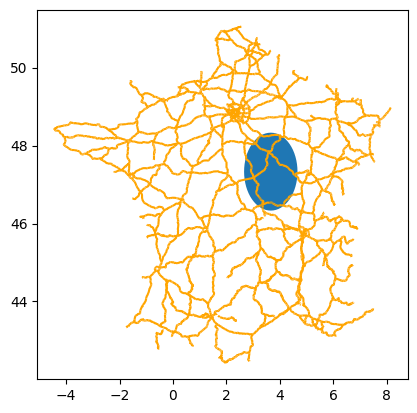

In [34]:
fig, ax = plt.subplots(1, 1)
communes_metropole.loc[communes_metropole['insee']=='58170','coords_centre'].buffer(1).plot(ax=ax)
tmja_enriched.loc[tmja_enriched['tmja']>0,:].plot(ax=ax, color='orange')

Un buffer de valeur 1 semble donc convenir

Récupération des index des routes grâce à la fonction spatial join de GeoPandas :

In [38]:
comm_met_reduce = communes_metropole[['insee', 'coords_centre']]
tmja_reduce = tmja_enriched[['road_index','Road_center']]

In [39]:
big_join_distance = comm_met_reduce.set_geometry("coords_centre").buffer(1).to_frame().sjoin(tmja_reduce.set_geometry('Road_center'), how='right')

/tmp/ipykernel_15500/401198121.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  big_join_distance = comm_met_reduce.set_geometry("coords_centre").buffer(1).to_frame().sjoin(tmja_reduce.set_geometry('Road_center'), how='right')


Grâce à un "group by" on peut observer le nombre de communes qui n'ont aucune route associée dans le résultat :

In [40]:
total_count_roads = big_join_distance.groupby('index_left').count()

In [41]:
total_count_roads.loc[total_count_roads['road_index']==0,:]

,road_index,Road_center
index_left,,


C'est ok... le buffer était assez grand

Il n'y en a aucune, ce qui signifie que notre buffer était assez gros. Il a fallu en plus prendre plus large, à cause de la déformation du buffer en hauteur et largeur.

On récupère, sous forme de Series de listes, puis de liste de liste, la liste des routes concurrentes pour chaque commune :

In [42]:
roads_list_global = big_join_distance.groupby('index_left')['road_index'].apply(list).to_list()

Puis on itère sur chaque commune, pour récupérer dans la liste des routes concurrentes, celles qui est la plus proche, en observant les coordonnées de cahque point de la routes, et en calculant la distance du centre de la commune à ce point :

ATTENTION : Temps long de calcul. Le fichier commune final a été exporté et peut être réimporté plus bas.

--------

In [49]:
nearlier_road_dist = []
nearlier_road = []
problematic_road = []

index_com_list = communes_metropole.index.to_list()
list_geometry_road = tmja_enriched.geometry.to_list()
geo_centers_road = tmja_enriched['Road_center'].geometry
geo_communes_centers = communes_metropole['coords_centre'].geometry

for k, coord_center in enumerate(geo_communes_centers):

    dist_minimal = DIST_VOL_OISEAU # valeur par défault si aucune distance n'est trouvée

    for road_index in roads_list_global[k]:
        try:
            list_coords_nearly=[tupple_coord for tupple_coord in list_geometry_road[road_index].coords]
            for i, road_list_points in enumerate(list_coords_nearly):
                min_for_this_road = min([geopy.distance.geodesic(coord_center.coords, tupple).meters for tupple in road_list_points])

                if min_for_this_road < dist_minimal:
                    dist_minimal = min_for_this_road
                    best_road = road_index
        except:
            try:
                list_coords_nearly.append([tupple for linestring in tmja_enriched.geometry[i].geoms for tupple in linestring.coords])
                for i, road_list_points in enumerate(list_coords_nearly):
                    min_for_this_road = min([geopy.distance.geodesic(coord_center.coords, tupple).meters for tupple in road_list_points])

                if min_for_this_road < dist_minimal:
                    dist_minimal = min_for_this_road
                    best_road = road_index
            except:
                min_for_this_road = geopy.distance.geodesic(coord_center.coords, geo_centers_road[road_index].coords).meters

                if min_for_this_road < dist_minimal:
                    dist_minimal = min_for_this_road
                    best_road = road_index

                problematic_road.append(road_index)

    nearlier_road_dist.append(dist_minimal)
    nearlier_road.append(best_road)

    if k%100==0:
        print(f'{k} communes completed...')

communes_metropole['nearlier_road'] = nearlier_road
communes_metropole['nearlier_road_dist']=  nearlier_road_dist

0 communes completed...
100 communes completed...
200 communes completed...
300 communes completed...
400 communes completed...
500 communes completed...
600 communes completed...
700 communes completed...
800 communes completed...
900 communes completed...
1000 communes completed...
1100 communes completed...
1200 communes completed...
1300 communes completed...
1400 communes completed...
1500 communes completed...
1600 communes completed...
1700 communes completed...
1800 communes completed...
1900 communes completed...
2000 communes completed...
2100 communes completed...
2200 communes completed...
2300 communes completed...
2400 communes completed...
2500 communes completed...
2600 communes completed...
2700 communes completed...
2800 communes completed...
2900 communes completed...
3000 communes completed...
3100 communes completed...
3200 communes completed...
3300 communes completed...
3400 communes completed...
3500 communes completed...
3600 communes completed...
3700 communes

/home/jesshuan/miniconda3/envs/ECartoMobile/lib/python3.11/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
/home/jesshuan/miniconda3/envs/ECartoMobile/lib/python3.11/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


Export save :

In [50]:
file_name = 'communes_metro_with_nearlier_road.feather'

communes_metropole.to_feather(os.path.join(data_path, file_name))

Import : 

In [5]:
file_name = 'communes_metro_with_nearlier_road.feather'

communes_metropole = gpd.read_feather(os.path.join(data_path, file_name))

JOINTURE :

In [8]:
tmja_enriched.keys()

Index(['road_index', 'dateRefere', 'route', 'longueur', 'prD', 'depPrD',
       'concession', 'absD', 'cumulD', 'xD', 'yD', 'zD', 'prF', 'depPrF',
       'concessi_1', 'absF', 'cumulF', 'xF', 'yF', 'zF', 'cote', 'anneeMesur',
       'typeCompta', 'tmja', 'pctPL', 'geometry', 'Road_center', 'betweeness',
       'betweeness_stand', 'lat_center', 'lon_center'],
      dtype='object')

In [12]:
communes_metropole = communes_metropole.merge(tmja_enriched[['road_index','tmja','betweeness', 'betweeness_stand']], how='left', left_on='nearlier_road', right_on='road_index')

In [14]:
communes_metropole.head()

,insee,nom,wikipedia,surf_ha,geometry,coords_centre,nearlier_road,nearlier_road_dist,road_index,tmja,betweeness,betweeness_stand
0,66113,Montbolo,fr:Montbolo,2230.0,"POLYGON ((2.58733 42.49499, 2.58771 42.49587, ...",POINT (2.63221 42.49107),4796,18980.409367,4796,15498.0,25215.0,10.135234
1,66202,Targasonne,fr:Targasonne,787.0,"POLYGON ((1.96642 42.49779, 1.96661 42.49824, ...",POINT (1.98852 42.50352),4826,6341.065037,4826,3906.0,175455.0,12.075144
2,66001,L'Albère,fr:L'Albère,1620.0,"POLYGON ((2.86121 42.47796, 2.86131 42.47832, ...",POINT (2.89587 42.47598),429,3774.372674,429,32877.0,0.0,0.000000
3,66117,Mont-Louis,fr:Mont-Louis (Pyrénées-Orientales),38.0,"POLYGON ((2.11419 42.51061, 2.11436 42.51119, ...",POINT (2.11967 42.51002),4822,497.027058,4822,5279.0,155527.0,11.954581
4,66072,Estavar,fr:Estavar,926.0,"POLYGON ((1.98630 42.47544, 1.98636 42.47555, ...",POINT (2.00933 42.47497),4826,2650.517409,4826,3906.0,175455.0,12.075144


---

In [27]:
def fast_visualization_specific_column(geo_df, colum_key):

    fig = px.scatter_mapbox(geo_df, lat='lat_center', lon='lon_center', color=colum_key, size=colum_key, mapbox_style='open-street-map')

    fig.show()

Etude du betweeness associé aux communes :

In [21]:
geo_communes_centers = communes_metropole['coords_centre'].geometry

In [25]:
lon_list = [coord_center.coords[0][0] for coord_center in geo_communes_centers]
lat_list = [coord_center.coords[0][1] for coord_center in geo_communes_centers]

In [26]:
communes_metropole['lat_center'] = lat_list
communes_metropole['lon_center'] = lon_list

In [181]:
fast_visualization_specific_column(communes_metropole, 'betweeness_stand')

In [17]:
fig = px.histogram(communes_metropole, x='betweeness_stand')
fig.show()

In [18]:
fig = px.box(communes_metropole, x='betweeness_stand')
fig.show()

Problème : des betweeness "outliers" risquent d'être trop bas, et refléter une situation inadéquate (aux frontières). Par sécurité, on va un peu booster les outliers bas en conservant l'ordre.

Déviation standard :

In [83]:
communes_metropole['betweeness_stand'].std()

4.0680054688848015

Recherche d'une loi de distribution qui satisfasse aux conditions :

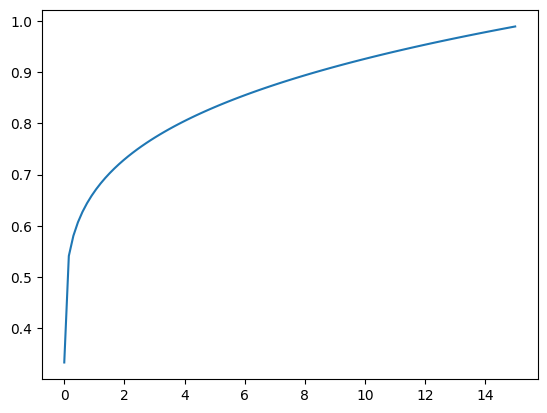

In [105]:
import matplotlib.pyplot as plt

x = np.linspace(0, 15, 100)
y = (x**(1/4)+1)/3

plt.plot(x, y)

plt.show() # affiche la figure à l'écran

In [106]:
communes_metropole['betweeness_corr'] = (communes_metropole['betweeness_stand']**(1/2) + 1)/5

In [107]:
fig = px.histogram(communes_metropole, x='betweeness_corr')
fig.show()

In [108]:
fig = px.box(communes_metropole, x='betweeness_corr')
fig.show()

On garde les deux betweeness (brut et corrigé pour voir les différences)

----

Etude de la distance à la route pour chaque commune :

In [180]:
fast_visualization_specific_column(communes_metropole, 'nearlier_road_dist')

C'est cohérent, en zoomant, on voit tout simplement apparaître le réseau.

----

Etude du TMJA (associé aux communes)

In [119]:
fig = px.histogram(communes_metropole, 'tmja')
fig.show()

Application du min-max :

In [141]:
tmja_max = communes_metropole['tmja'].max()

In [142]:
communes_metropole['tmja_norm'] = communes_metropole['tmja'] / tmja_max

In [144]:
fast_visualization_specific_column(communes_metropole, 'tmja_norm')

In [145]:
0.3**(1/(1+0.1))

0.33469997977055177

LE TMJA reflète le passage total, et non le traffic tourstique. Il est ici à utliser avec des pincettes, car il risque d'écraser la finesse  du betweeness. Nous allons l'utiliser comme un petit coefficient d'amplification.

Sur un score déjà normalisé entre 0 et 1, on peut utiliser le tmja comme suit :

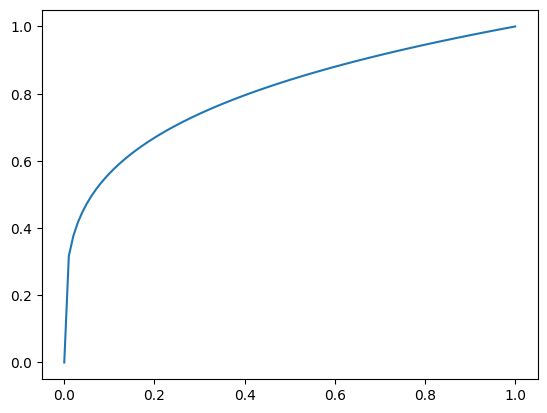

In [161]:
x = np.linspace(0, 1, 100)
y = x**(1/4)

plt.plot(x, y)

plt.show() # affiche la figure à l'écran

---

In [174]:
LIMIT_KM = 10000

In [175]:
alpha = np.log(2) / LIMIT_KM

In [182]:
communes_metropole['score_1'] = communes_metropole['betweeness_stand']*np.exp(- alpha * communes_metropole['nearlier_road_dist'])*communes_metropole['tmja_norm']**(1/4)

In [183]:
fast_visualization_specific_column(communes_metropole, 'score_1')

In [185]:
fig = px.histogram(communes_metropole, 'score_1')
fig.show()

In [189]:
#communes_metropole['score_1'] = communes_metropole['betweeness_corr']*np.exp(- alpha * communes_metropole['nearlier_road_dist'])*communes_metropole['tmja_norm']**(1/4)

In [195]:
communes_metropole['score_1'] = communes_metropole['betweeness_corr']*np.exp(- alpha * communes_metropole['nearlier_road_dist'])**(1/(1+communes_metropole['tmja_norm']))

In [192]:
#communes_metropole['score_1'] = communes_metropole['betweeness_corr']*np.exp(- alpha * communes_metropole['nearlier_road_dist'])

In [197]:
fast_visualization_specific_column(communes_metropole, 'score_1')

In [196]:
fig = px.histogram(communes_metropole, 'score_1')
fig.show()

In [199]:
file_name = 'communes_metro_with_score_1.feather'

communes_metropole.to_feather(os.path.join(data_path, file_name))